In [32]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [33]:
### Initial imports
import logging
import numpy as np
import pandas as pd
import pymc3 as pm
import theano.tensor as T
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("ticks")

logging.basicConfig(level=logging.INFO)
log = logging.getLogger(__name__)

import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

from epimodel.pymc3_models import cm_effect
from epimodel.pymc3_models.cm_effect.datapreprocessor import DataPreprocessor

%matplotlib inline

INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Smoothing
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Albania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Andorra
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Estonia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Iceland
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Latvia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Lithuania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing New Zealand
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Singapore
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Slovakia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Masking


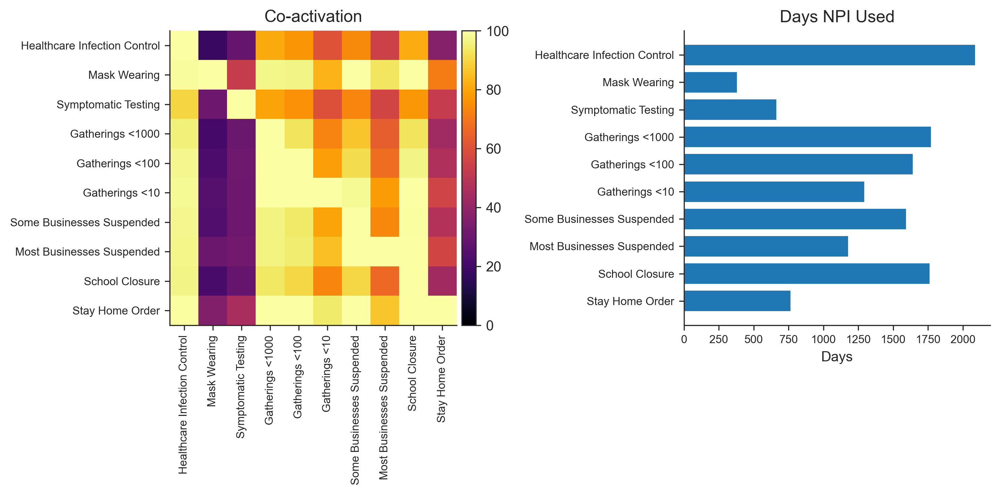

In [36]:
dp = DataPreprocessor(mask_zero_cases = True)
data = dp.preprocess_data("data_final.csv")

In [37]:
data.Ds

[Timestamp('2020-01-22 00:00:00+0000', tz='UTC'),
 Timestamp('2020-01-23 00:00:00+0000', tz='UTC'),
 Timestamp('2020-01-24 00:00:00+0000', tz='UTC'),
 Timestamp('2020-01-25 00:00:00+0000', tz='UTC'),
 Timestamp('2020-01-26 00:00:00+0000', tz='UTC'),
 Timestamp('2020-01-27 00:00:00+0000', tz='UTC'),
 Timestamp('2020-01-28 00:00:00+0000', tz='UTC'),
 Timestamp('2020-01-29 00:00:00+0000', tz='UTC'),
 Timestamp('2020-01-30 00:00:00+0000', tz='UTC'),
 Timestamp('2020-01-31 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-01 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-02 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-03 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-04 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-05 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-06 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-07 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-08 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-09 00:00:00+0000', tz='UTC'),
 Timestamp('2020-02-10 00:00:00+0000', tz='UTC'),


In [41]:
Ds = data.Ds[14:]

In [26]:
def mask_region_ends(d, region, ndays=10):
    i = d.Rs.index(region)
    d.Active.mask[i,-ndays:] = True
    d.Confirmed.mask[i,-ndays:] = True
    d.Deaths.mask[i,-ndays:] = True
    d.NewDeaths.mask[i,-ndays:] = True
    d.NewCases.mask[i,-ndays:] = True

for region in data.Rs:
    mask_region_ends(data, region, 7)

In [27]:
with cm_effect.models.CMCombined_R_NewCases(data) as model:
    model.build_model()

/Users/mrinank/Library/Caches/pypoetry/virtualenvs/epimodel-H-ywULmv-py3.7/lib/python3.7/site-packages/pymc3/model.py:1430: ImputationWarning: Data in ObservedActiveLog contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)
/Users/mrinank/Library/Caches/pypoetry/virtualenvs/epimodel-H-ywULmv-py3.7/lib/python3.7/site-packages/pymc3/model.py:1430: ImputationWarning: Data in ObservedDeaths contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)


In [30]:
len(data.Ds)

95

In [31]:
data.ActiveCMs.shape

(41, 10, 95)

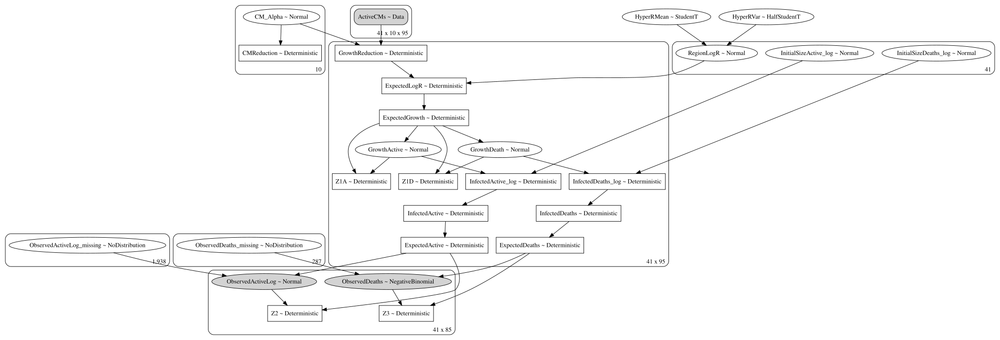

In [28]:
pm.model_to_graphviz(model).render("model-combined")
pm.model_to_graphviz(model)

In [18]:
with model.model:
    model.trace = pm.sample(2000, chains=2)

Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
CompoundStep
INFO:pymc3:CompoundStep
>NUTS: [InitialSizeDeaths_log, ObservedActiveLog_missing, InitialSizeActive_log, GrowthDeath, GrowthActive, RegionLogR, HyperRVar, HyperRMean, CM_Alpha]
INFO:pymc3:>NUTS: [InitialSizeDeaths_log, ObservedActiveLog_missing, InitialSizeActive_log, GrowthDeath, GrowthActive, RegionLogR, HyperRVar, HyperRMean, CM_Alpha]
>Metropolis: [ObservedDeaths_missing]
INFO:pymc3:>Metropolis: [ObservedDeaths_missing]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [1:13:33<00:00,  1.13draws/s]
The rhat statistic is larger than 1.4 for some parameters. The sampler did not converge.
ERROR:pymc3:The rhat statistic is larger than 1.4 for some parameters. The sampler did not converge.
The estimated number of effective samples is smaller than 200 for some parameters.
ERROR:pymc3:The estimated number of effective samples is smaller than 200 for some parameters.


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out


<Figure size 2100x900 with 0 Axes>

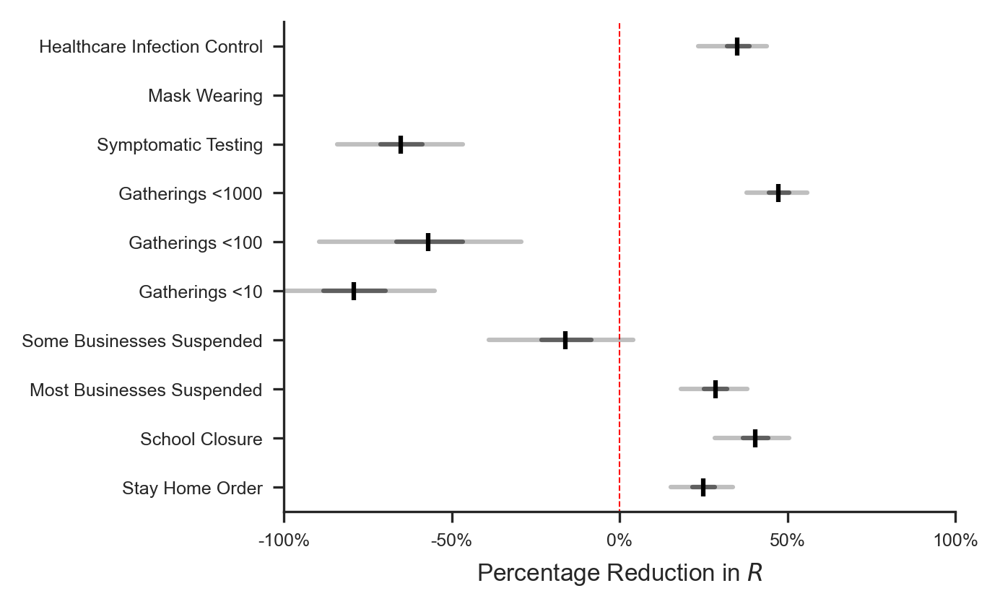

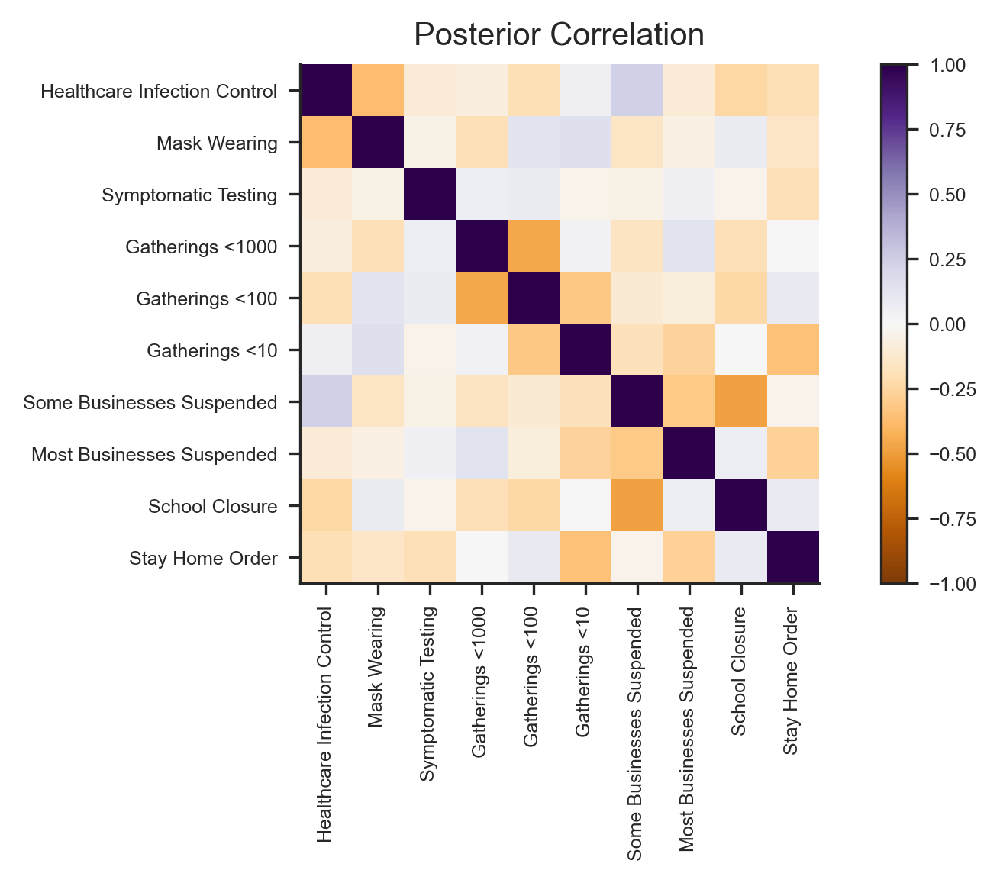

In [19]:
model.plot_effect()

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out
INFO:epimodel.pymc3_models.cm_effe

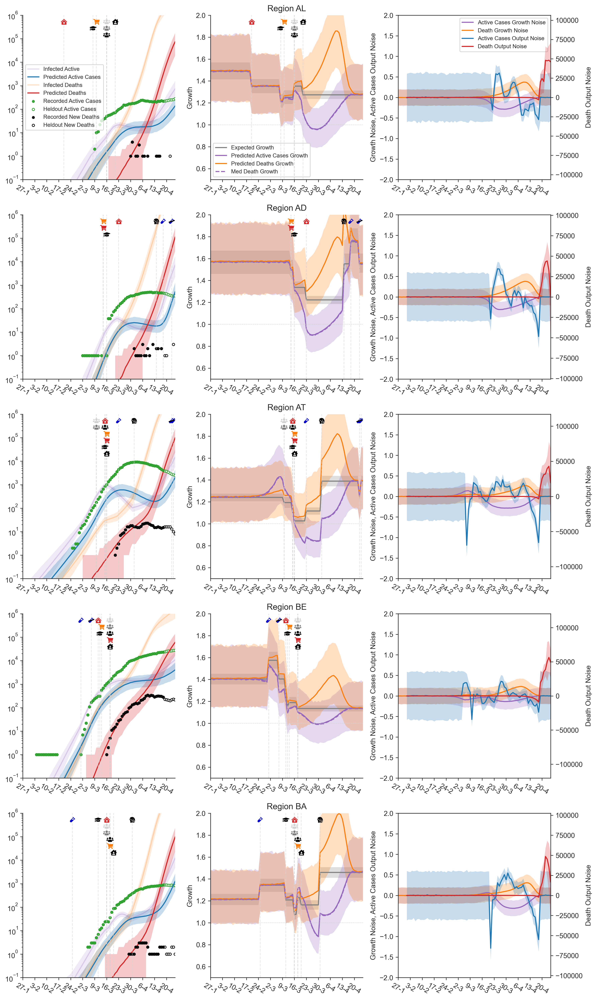

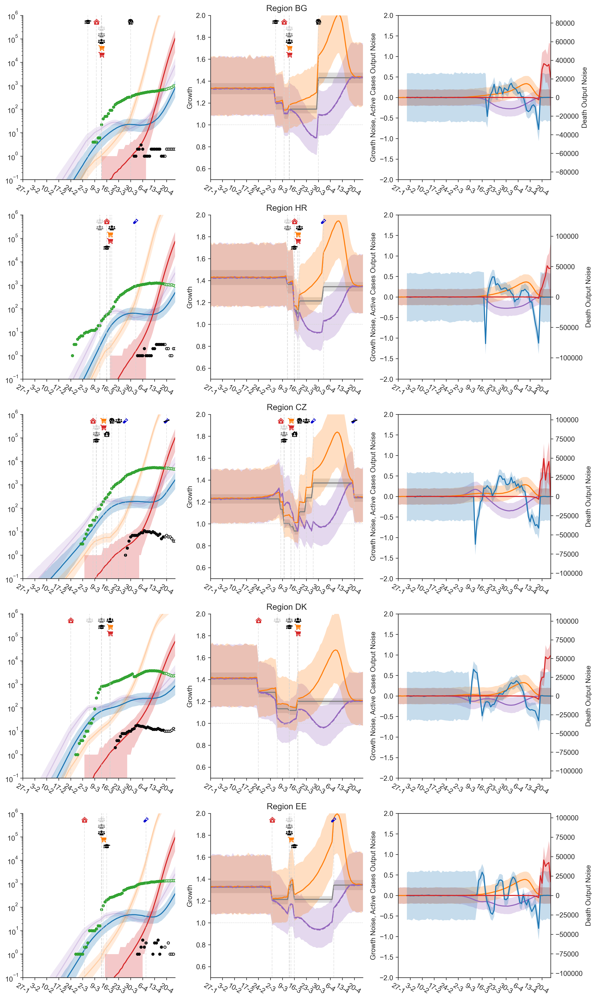

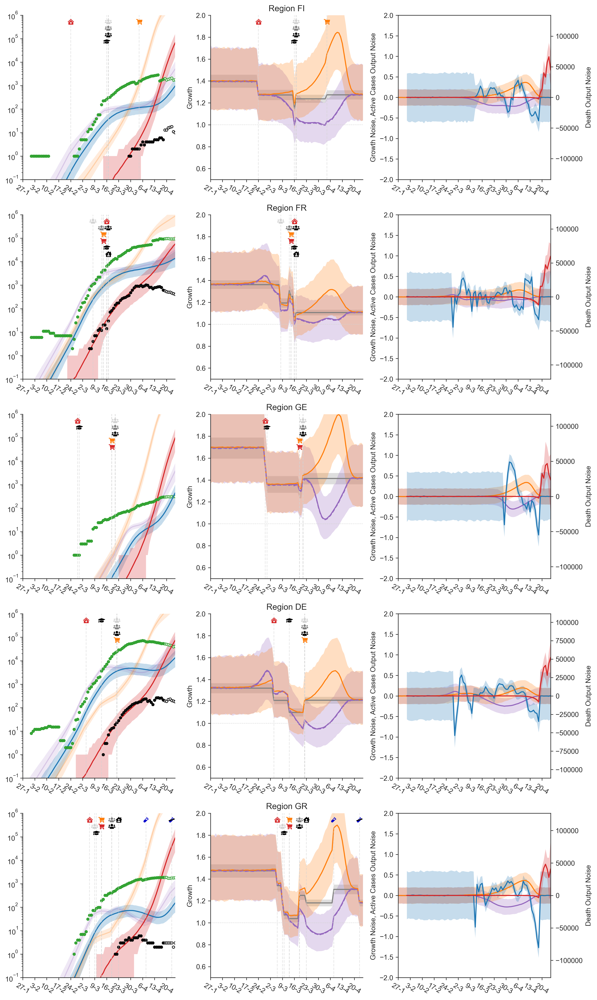

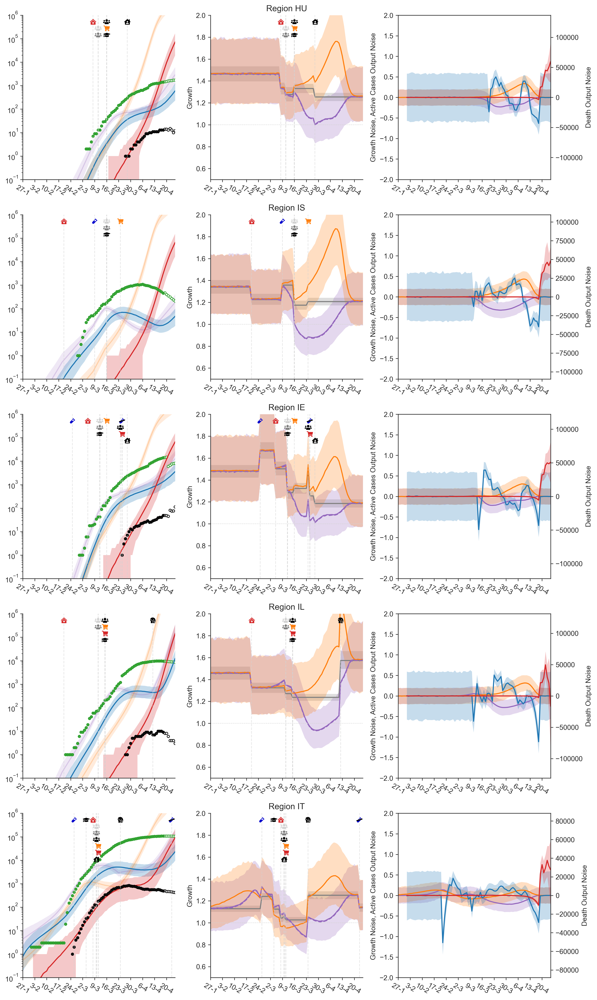

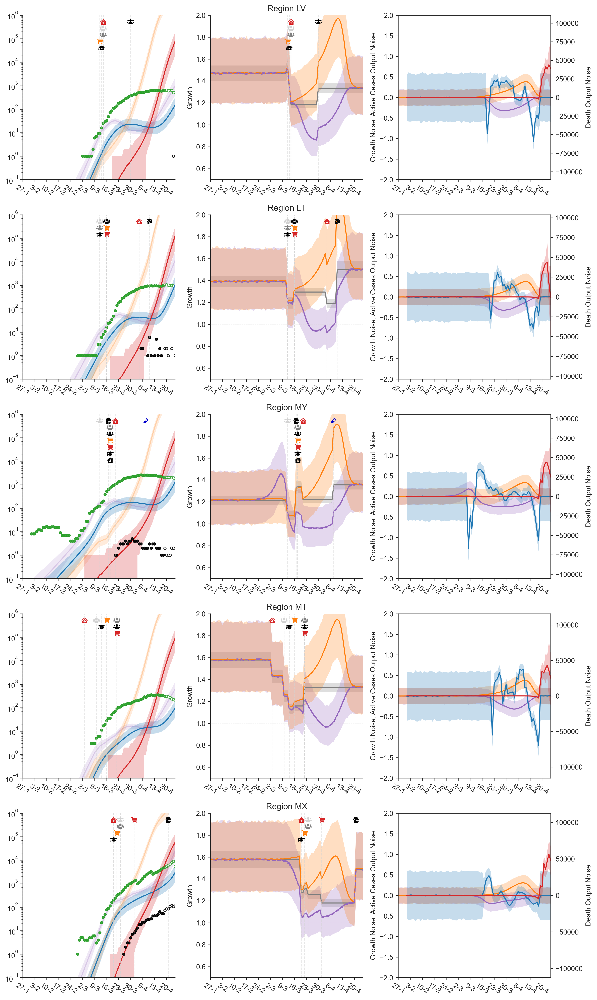

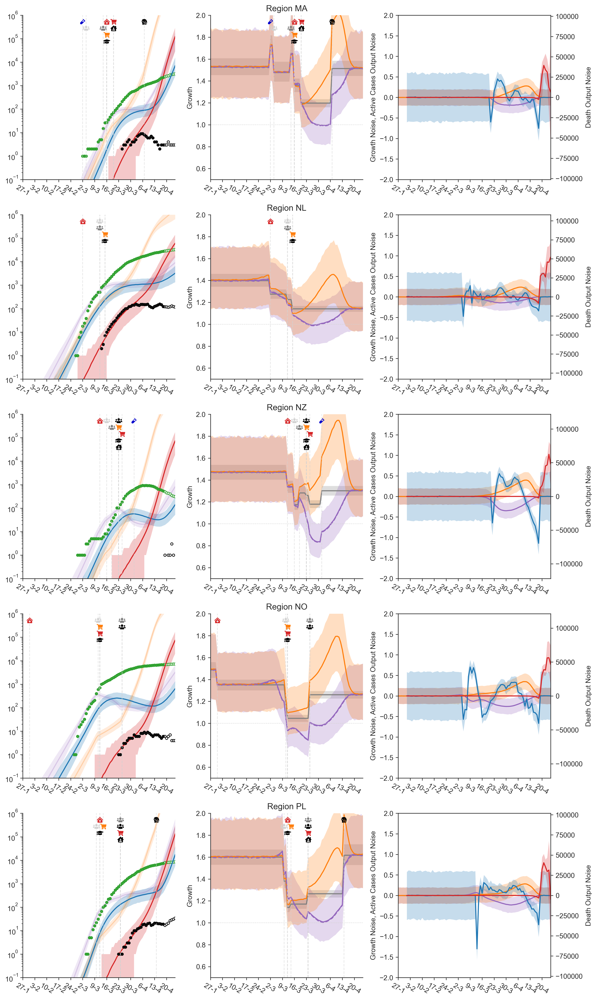

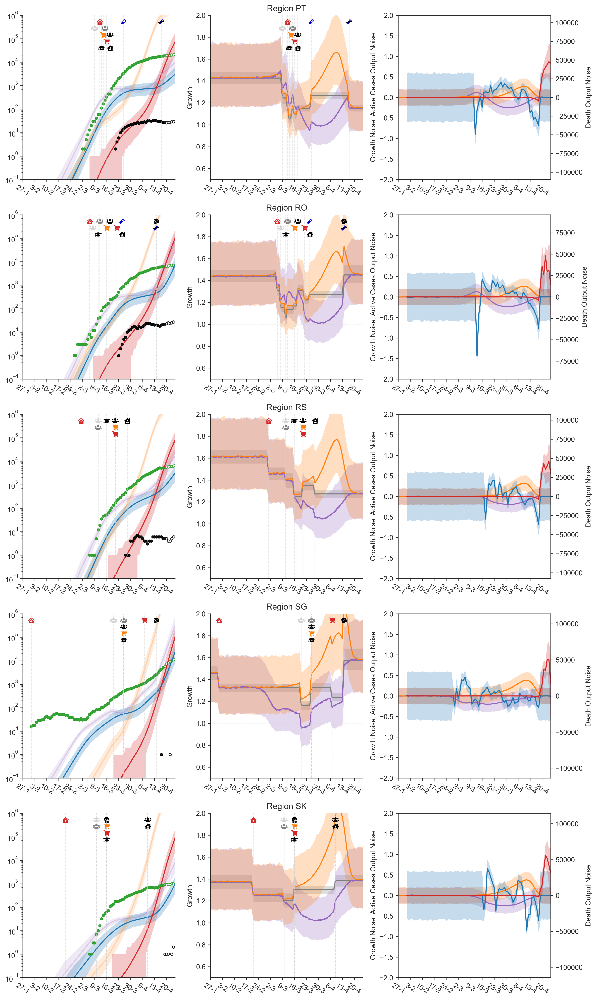

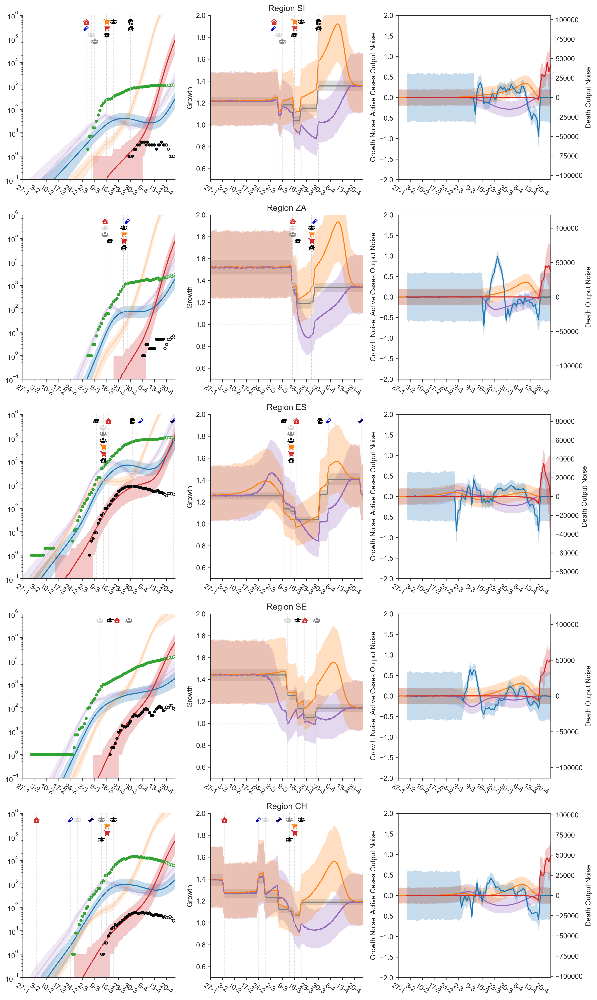

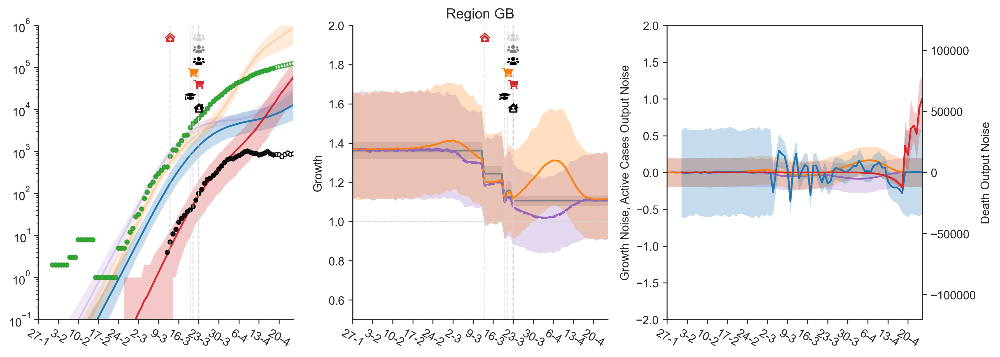

In [22]:
cm_plot_style = [
            ("\uf7f2", "tab:red"), # hospital symbol
            ("\uf963", "black"), # mask
            ("\uf492", "mediumblue"), # vial
            ("\uf0c0", "lightgrey"), # ppl
            ("\uf0c0", "grey"), # ppl
            ("\uf0c0", "black"), # ppl
            ("\uf07a", "tab:orange"), # shop 1
            ("\uf07a", "tab:red"), # shop2 
            ("\uf19d", "black"), # school
            ("\uf965", "black") # home
        ]

model.plot_region_predictions(cm_plot_style)